In [1]:
# Test API with my unique key
# necessary import
from requests import Request, Session
from requests.exceptions import ConnectionError, Timeout, TooManyRedirects
from time import time
from time import sleep
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import json
import os

url = 'https://pro-api.coinmarketcap.com/v1/cryptocurrency/listings/latest' # domain updated
parameters = {
  'start':'1',
  'limit':'5000',
  'convert':'USD'
}
headers = {
  'Accepts': 'application/json',
  'X-CMC_PRO_API_KEY': '724b7cc8-f267-4661-87fd-a712639e7859' # my API key
}

session = Session()
session.headers.update(headers)

try:
  response = session.get(url, params = parameters)
  data = json.loads(response.text)
  print(data)
except (ConnectionError, Timeout, TooManyRedirects) as e:
  print(e)

{'status': {'timestamp': '2024-07-29T07:33:36.150Z', 'error_code': 0, 'error_message': None, 'elapsed': 73, 'credit_count': 25, 'notice': None, 'total_count': 10022}, 'data': [{'id': 1, 'name': 'Bitcoin', 'symbol': 'BTC', 'slug': 'bitcoin', 'num_market_pairs': 11617, 'date_added': '2010-07-13T00:00:00.000Z', 'tags': ['mineable', 'pow', 'sha-256', 'store-of-value', 'state-channel', 'coinbase-ventures-portfolio', 'three-arrows-capital-portfolio', 'polychain-capital-portfolio', 'binance-labs-portfolio', 'blockchain-capital-portfolio', 'boostvc-portfolio', 'cms-holdings-portfolio', 'dcg-portfolio', 'dragonfly-capital-portfolio', 'electric-capital-portfolio', 'fabric-ventures-portfolio', 'framework-ventures-portfolio', 'galaxy-digital-portfolio', 'huobi-capital-portfolio', 'alameda-research-portfolio', 'a16z-portfolio', '1confirmation-portfolio', 'winklevoss-capital-portfolio', 'usv-portfolio', 'placeholder-ventures-portfolio', 'pantera-capital-portfolio', 'multicoin-capital-portfolio', 'pa

Note that an error may occur. To fix it and allow to pull data, put `"jupyter notebook --NotebookApp.iopub_data_rate_limit=1e10"` into the Anaconda Prompt. It's is even better to close jupyter notebook and open it with this code from the Anaconda Prompt.

In [3]:
type(data) # check the type of data pulled

dict

In [5]:
# To display all columns and rows
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

# Build dataframe
df = pd.json_normalize(data["data"])

In [5]:
df["timestamp"] = pd.to_datetime("now") # adding a timestamp
df.head()

,id,name,symbol,slug,num_market_pairs,date_added,tags,max_supply,circulating_supply,total_supply,infinite_supply,platform,cmc_rank,self_reported_circulating_supply,self_reported_market_cap,tvl_ratio,last_updated,quote.USD.price,quote.USD.volume_24h,quote.USD.volume_change_24h,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d,quote.USD.market_cap,quote.USD.market_cap_dominance,quote.USD.fully_diluted_market_cap,quote.USD.tvl,quote.USD.last_updated,platform.id,platform.name,platform.symbol,platform.slug,platform.token_address,timestamp
0,1,Bitcoin,BTC,bitcoin,11617,2010-07-13T00:00:00.000Z,"[mineable, pow, sha-256, store-of-value, state...",21000000.0,1.973265e+07,19732653,False,NaN,1,NaN,NaN,NaN,2024-07-29T07:31:00.000Z,69541.616650,2.258663e+10,-38.0762,-0.393799,3.154662,3.421723,14.029316,2.649200,9.742874,1.372241e+12,55.4710,1.460374e+12,NaN,2024-07-29T07:31:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:52.299987
1,1027,Ethereum,ETH,ethereum,9177,2015-08-07T00:00:00.000Z,"[pos, smart-contracts, ethereum-ecosystem, coi...",NaN,1.202283e+08,120228315.019602,True,NaN,2,NaN,NaN,NaN,2024-07-29T07:30:00.000Z,3371.002257,1.126972e+10,-26.8258,-0.406442,4.651952,-2.930830,-0.706279,-9.832105,6.347045,4.052899e+11,16.3812,4.052899e+11,NaN,2024-07-29T07:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:52.299987
2,825,Tether USDt,USDT,tether,92838,2015-02-25T00:00:00.000Z,"[stablecoin, asset-backed-stablecoin, avalanch...",NaN,1.144179e+11,117068083204.491638,True,NaN,3,NaN,NaN,NaN,2024-07-29T07:30:00.000Z,0.999933,4.094484e+10,-27.8944,0.008447,-0.010587,-0.039463,0.151906,0.047202,-0.001137,1.144101e+11,4.6251,1.170602e+11,NaN,2024-07-29T07:30:00.000Z,1027.0,Ethereum,ETH,ethereum,0xdac17f958d2ee523a2206206994597c13d831ec7,2024-07-29 08:33:52.299987
3,5426,Solana,SOL,solana,709,2020-04-10T00:00:00.000Z,"[pos, platform, solana-ecosystem, cms-holdings...",NaN,4.647105e+08,581039213.170621,True,NaN,4,NaN,NaN,NaN,2024-07-29T07:30:00.000Z,191.778103,2.603319e+09,-20.7134,-0.861343,5.121403,7.613414,35.096442,15.910695,41.109130,8.912129e+10,3.6028,1.114306e+11,NaN,2024-07-29T07:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:52.299987
4,1839,BNB,BNB,bnb,2200,2017-07-25T00:00:00.000Z,"[marketplace, centralized-exchange, payments, ...",NaN,1.459376e+08,145937559.530054,False,NaN,5,NaN,NaN,NaN,2024-07-29T07:30:00.000Z,593.733378,1.572913e+09,-9.1408,-0.090499,2.837740,0.135899,4.087658,0.191257,-1.316115,8.664800e+10,3.5028,8.664800e+10,NaN,2024-07-29T07:30:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:52.299987


The column `last_updated` contains the time registered by coinmarket website API from the moment it pulled the data. It is a bit different from our own timestamp.

In [7]:
# Automate the data sourcing to add more data
def api_runner():
    global df # original dataset sourced earlier
    
    # Pull data from API
    url = 'https://pro-api.coinmarketcap.com/v1/cryptocurrency/listings/latest' # url address
    parameters = {
      'start':'1',
      'limit':'5000',
      'convert':'USD'
    }
    headers = {
      'Accepts': 'application/json',
      'X-CMC_PRO_API_KEY': '724b7cc8-f267-4661-87fd-a712639e7859' # my API key
    }
    
    session = Session()
    session.headers.update(headers)
    
    try:
      response = session.get(url, params = parameters) # get web page
      data = json.loads(response.text) # pull data
      print(data)
    except (ConnectionError, Timeout, TooManyRedirects) as e:
      print(e)
    
    ## For Dataframe only:
    # Build dataframe for new data and append to the original one
    # df2 = pd.json_normalize(data["data"]) # new data
    # df2["timestamp"] = pd.to_datetime("now") # adding a timestamp
    # df = pd.concat([df, df2]) # to append data

    ## For csv file:
    # Prepare new data
    df = pd.json_normalize(data["data"])
    df["timestamp"] = pd.to_datetime("now")
    
    # Save new data into csv file
    if not os.path.isfile('API.csv'): # if the csv file doesn't exist
        df.to_csv('API.csv', header = "column_names", index = False) # create it with its headers
    else: # if it does
        df.to_csv('API.csv', mode = "a", header = False, index = False) # just add the data without hearders

In [9]:
# To automatically run the `api_runner` defined above
# necessary import
import os
from time import time
from time import sleep

for i in range(3): # 333 runs is the maximum per day
    api_runner() # run the API
    print("API Done!") # track the running
    sleep(60) # to make it run every minute
exit()

In [2]:
# In case the kernel die:
# Necessary import
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Display all columns and rows
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

In [3]:
# read data
df = pd.read_csv("API.csv")
df.head()

,id,name,symbol,slug,num_market_pairs,date_added,tags,max_supply,circulating_supply,total_supply,infinite_supply,platform,cmc_rank,self_reported_circulating_supply,self_reported_market_cap,tvl_ratio,last_updated,quote.USD.price,quote.USD.volume_24h,quote.USD.volume_change_24h,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d,quote.USD.market_cap,quote.USD.market_cap_dominance,quote.USD.fully_diluted_market_cap,quote.USD.tvl,quote.USD.last_updated,platform.id,platform.name,platform.symbol,platform.slug,platform.token_address,timestamp
0,1,Bitcoin,BTC,bitcoin,11617,2010-07-13T00:00:00.000Z,"['mineable', 'pow', 'sha-256', 'store-of-value...",21000000.0,1.973265e+07,1.973265e+07,False,NaN,1,NaN,NaN,NaN,2024-07-29T07:33:00.000Z,69522.494842,2.261667e+10,-37.9296,-0.359380,3.128937,3.293200,14.016294,2.619284,9.818859,1.371863e+12,55.4557,1.459972e+12,NaN,2024-07-29T07:33:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:58.484584
1,1027,Ethereum,ETH,ethereum,9177,2015-08-07T00:00:00.000Z,"['pos', 'smart-contracts', 'ethereum-ecosystem...",NaN,1.202283e+08,1.202283e+08,True,NaN,2,NaN,NaN,NaN,2024-07-29T07:32:00.000Z,3369.059831,1.129327e+10,-26.6678,-0.460163,4.605667,-3.074279,-0.739910,-9.855634,6.362819,4.050564e+11,16.3718,4.050564e+11,NaN,2024-07-29T07:32:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:58.484584
2,825,Tether USDt,USDT,tether,92839,2015-02-25T00:00:00.000Z,"['stablecoin', 'asset-backed-stablecoin', 'ava...",NaN,1.144179e+11,1.170681e+11,True,NaN,3,NaN,NaN,NaN,2024-07-29T07:32:00.000Z,0.999906,4.100467e+10,-27.7136,0.005438,-0.007933,-0.029022,0.139785,0.055322,-0.071181,1.144070e+11,4.6226,1.170570e+11,NaN,2024-07-29T07:32:00.000Z,1027.0,Ethereum,ETH,ethereum,0xdac17f958d2ee523a2206206994597c13d831ec7,2024-07-29 08:33:58.484584
3,5426,Solana,SOL,solana,709,2020-04-10T00:00:00.000Z,"['pos', 'platform', 'solana-ecosystem', 'cms-h...",NaN,4.647104e+08,5.810391e+08,True,NaN,4,NaN,NaN,NaN,2024-07-29T07:32:00.000Z,191.799149,2.617832e+09,-20.2208,-0.842709,5.144686,7.679098,35.023131,16.020096,41.187934,8.913106e+10,3.6013,1.114428e+11,NaN,2024-07-29T07:32:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:58.484584
4,1839,BNB,BNB,bnb,2200,2017-07-25T00:00:00.000Z,"['marketplace', 'centralized-exchange', 'payme...",NaN,1.459376e+08,1.459376e+08,False,NaN,5,NaN,NaN,NaN,2024-07-29T07:32:00.000Z,593.579882,1.571438e+09,-9.1394,-0.215025,2.799830,0.093457,4.076572,0.125716,-1.492838,8.662560e+10,3.5001,8.662560e+10,NaN,2024-07-29T07:32:00.000Z,NaN,NaN,NaN,NaN,NaN,2024-07-29 08:33:58.484584


In [6]:
# reformat float numbers
pd.set_option("display.float_format", lambda x: "%.5f" %x)

In [8]:
df.columns # all columns names

Index(['id', 'name', 'symbol', 'slug', 'num_market_pairs', 'date_added',
       'tags', 'max_supply', 'circulating_supply', 'total_supply',
       'infinite_supply', 'platform', 'cmc_rank',
       'self_reported_circulating_supply', 'self_reported_market_cap',
       'tvl_ratio', 'last_updated', 'quote.USD.price', 'quote.USD.volume_24h',
       'quote.USD.volume_change_24h', 'quote.USD.percent_change_1h',
       'quote.USD.percent_change_24h', 'quote.USD.percent_change_7d',
       'quote.USD.percent_change_30d', 'quote.USD.percent_change_60d',
       'quote.USD.percent_change_90d', 'quote.USD.market_cap',
       'quote.USD.market_cap_dominance', 'quote.USD.fully_diluted_market_cap',
       'quote.USD.tvl', 'quote.USD.last_updated', 'platform.id',
       'platform.name', 'platform.symbol', 'platform.slug',
       'platform.token_address', 'timestamp'],
      dtype='object')

In [10]:
# Bitcoins trends over time
btc_trend_df = df.groupby("name", sort = False)[['quote.USD.percent_change_1h',
       'quote.USD.percent_change_24h', 'quote.USD.percent_change_7d',
       'quote.USD.percent_change_30d', 'quote.USD.percent_change_60d',
       'quote.USD.percent_change_90d']].mean()
btc_trend_df

,quote.USD.percent_change_1h,quote.USD.percent_change_24h,quote.USD.percent_change_7d,quote.USD.percent_change_30d,quote.USD.percent_change_60d,quote.USD.percent_change_90d
name,,,,,,
Bitcoin,-0.26753,3.15365,3.29238,14.03854,2.58793,9.87891
Ethereum,-0.35148,4.62216,-3.08667,-0.73444,-9.85508,6.41372
Tether USDt,-0.00894,-0.00308,-0.03484,0.14681,0.05277,-0.02404
Solana,-0.72061,5.19243,7.66699,35.09639,16.13494,41.33407
BNB,-0.17901,2.78984,0.04918,4.05784,0.15327,-1.45733
XRP,0.26612,1.45020,3.18378,28.37381,17.76103,19.08727
USDC,-0.00602,0.00756,0.00347,0.01535,-0.01011,-0.00556
Dogecoin,-0.01071,3.32432,-2.59359,8.15800,-15.88855,-5.81213
Toncoin,-0.06448,3.60481,-4.34194,-9.84976,5.36105,26.13872


In [12]:
btc_trend_df = btc_trend_df.stack() # get column names as rows to stack our dataframe
btc_trend_df

name                                                                              
Bitcoin                                               quote.USD.percent_change_1h               -0.26753
                                                      quote.USD.percent_change_24h               3.15365
                                                      quote.USD.percent_change_7d                3.29238
                                                      quote.USD.percent_change_30d              14.03854
                                                      quote.USD.percent_change_60d               2.58793
                                                      quote.USD.percent_change_90d               9.87891
Ethereum                                              quote.USD.percent_change_1h               -0.35148
                                                      quote.USD.percent_change_24h               4.62216
                                                      quote.USD.percent_chang

In [14]:
type(btc_trend_df) # the type has changed

pandas.core.series.Series

In [16]:
btc_trend_df = btc_trend_df.to_frame(name = "values") # format as dataframe
btc_trend_df

values
name                                                                                               
Bitcoin                                            quote.USD.percent_change_1h             -0.26753
                                                   quote.USD.percent_change_24h             3.15365
                                                   quote.USD.percent_change_7d              3.29238
                                                   quote.USD.percent_change_30d            14.03854
                                                   quote.USD.percent_change_60d             2.58793
                                                   quote.USD.percent_change_90d             9.87891
Ethereum                                           quote.USD.percent_change_1h             -0.35148
                                                   quote.USD.percent_change_24h             4.62216
                                                   quote.USD.percent_change_7d             -3.08667
                                                   quote.USD.percent_change_30d            -0.73444
                                                   quote.USD.percent_change_60d            -9.85508
                                                   quote.USD.percent_change_90d             6.41372
Tether USDt                                        quote.USD.percent_change_1h             -0.00894
                                                   quote.USD.percent_change_24h            -0.00308
                                                   quote.USD.percent_change_7d             -0.03484
                                                   quote.USD.percent_change_30d             0.14681
                                                   quote.USD.percent_change_60d             0.05277
                                                   quote.USD.percent_change_90d            -0.02404
Solana                                             quote.USD.percent_change_1h             -0.72061
                                                   quote.USD.percent_change_24h             5.19243
                                                   quote.USD.percent_change_7d              7.66699
                                                   quote.USD.percent_change_30d            35.09639
                                                   quote.USD.percent_change_60d            16.13494
                                                   quote.USD.percent_change_90d            41.33407
BNB                                                quote.USD.percent_change_1h             -0.17901
                                                   quote.USD.percent_change_24h             2.78984
                                                   quote.USD.percent_change_7d              0.04918
                                                   quote.USD.percent_change_30d             4.05784
                                                   quote.USD.percent_change_60d             0.15327
                                                   quote.USD.percent_change_90d            -1.45733
XRP                                                quote.USD.percent_change_1h              0.26612
                                                   quote.USD.percent_change_24h             1.45020
                                                   quote.USD.percent_change_7d              3.18378
                                                   quote.USD.percent_change_30d            28.37381
                                                   quote.USD.percent_change_60d            17.76103
                                                   quote.USD.percent_change_90d            19.08727
USDC                                               quote.USD.percent_change_1h             -0.00602
                                                   quote.USD.percent_change_24h             0.00756
                                                   quote.USD.percent_change_7d              0

In [17]:
btc_trend_df.count() # number of observations (len(btc_trend_df), btc_trend_df.shape[0])

values    29706
dtype: int64

In [20]:
btc_trend_df.reset_index(inplace = True) # reset the index
btc_trend_df.head()

,name,level_1,values
0,Bitcoin,quote.USD.percent_change_1h,-0.26753
1,Bitcoin,quote.USD.percent_change_24h,3.15365
2,Bitcoin,quote.USD.percent_change_7d,3.29238
3,Bitcoin,quote.USD.percent_change_30d,14.03854
4,Bitcoin,quote.USD.percent_change_60d,2.58793


In [22]:
btc_trend_df.rename(columns = {"level_1": "percent_change"}, # rename `level_1` column 
                    inplace = True) # or btc_trend_df.columns = ["name", "percent_change", "values"]
btc_trend_df.head()

,name,percent_change,values
0,Bitcoin,quote.USD.percent_change_1h,-0.26753
1,Bitcoin,quote.USD.percent_change_24h,3.15365
2,Bitcoin,quote.USD.percent_change_7d,3.29238
3,Bitcoin,quote.USD.percent_change_30d,14.03854
4,Bitcoin,quote.USD.percent_change_60d,2.58793


In [24]:
# Reformat `percent_change` column for better visualization
btc_trend_df["percent_change"] = btc_trend_df["percent_change"].str.split("_", expand = True)[2] # my method

# btc_trend_df["percent_change"] = btc_trend_df["percent_change"].replace(
#     ['quote.USD.percent_change_24h','quote.USD.percent_change_7d','quote.USD.percent_change_30d',
#      'quote.USD.percent_change_60d','quote.USD.percent_change_90d'],['24h','7d','30d','60d','90d'],
# ) # Alex Method

btc_trend_df.head()

,name,percent_change,values
0,Bitcoin,1h,-0.26753
1,Bitcoin,24h,3.15365
2,Bitcoin,7d,3.29238
3,Bitcoin,30d,14.03854
4,Bitcoin,60d,2.58793


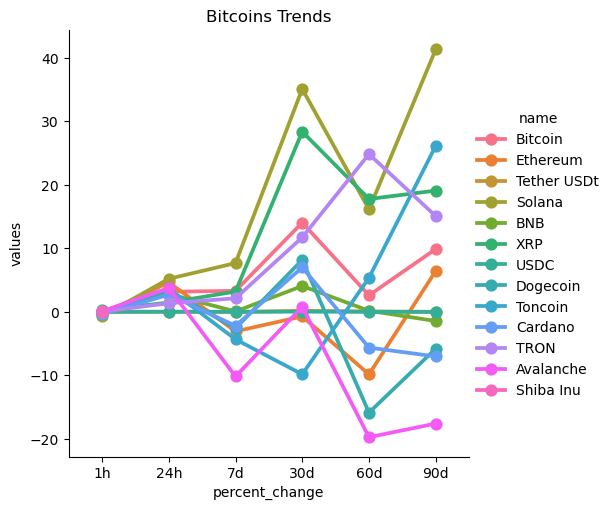

In [26]:
# Visualize bitcoins trends
sns.catplot(
    data = btc_trend_df.head(73), # subset of data for better visualization and less computational time
    x = "percent_change", y = "values",
    hue = "name", kind = "point"
)
plt.title("Bitcoins Trends");

In [28]:
# Dataframe for bitcoins prices over time
btc_prices = df[["name", "quote.USD.price", "timestamp"]]
btc_prices = btc_prices.query("name == 'Bitcoin'") # only for Bitcoin currency
btc_prices

,name,quote.USD.price,timestamp
0,Bitcoin,69522.49484,2024-07-29 08:33:58.484584
5000,Bitcoin,69538.35790,2024-07-29 08:35:05.303859
10000,Bitcoin,69545.63716,2024-07-29 08:36:12.366606


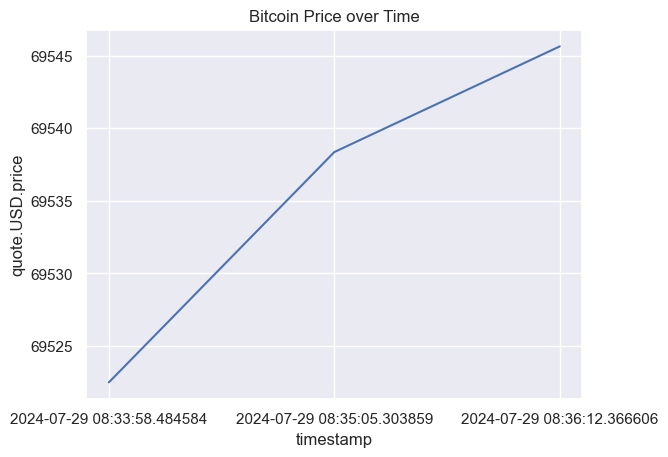

In [30]:
# Visualize Bitcoin price over time
sns.set_theme(style = "darkgrid") # set style
sns.lineplot(data = btc_prices, x = "timestamp", y = "quote.USD.price")
plt.title("Bitcoin Price over Time");

---